In [15]:
%load_ext autoreload
%autoreload 2
%env WANDB_SILENT=true

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
env: WANDB_SILENT=true


In [16]:
import torch
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, LearnedPerceptualImagePatchSimilarity
import utils
from models import UNetMod, UNetModECA
from denoisers.dip import DIP, DDIP, SGDIP, PatchDIP, losses, schedules

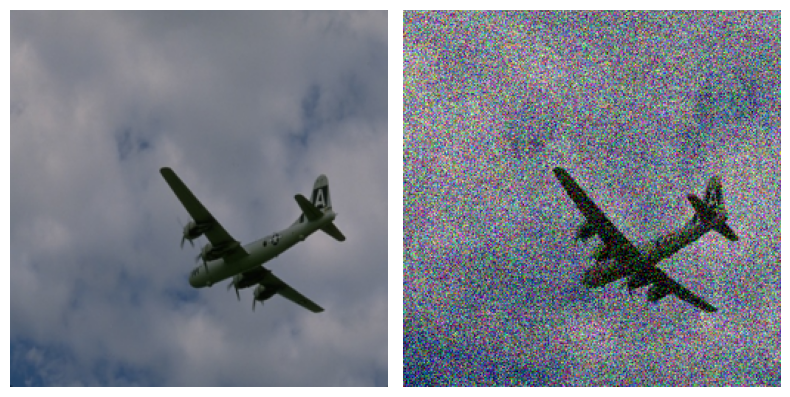

tensor(15.0019)


In [17]:
# clean = utils.load_celeba(30)
clean = utils.load_images('./data/CBSD68/')[:20]
# clean = utils.load_images('./data/Set14/')
# clean = utils.load_image("./data/set5/butterfly.png")
noisy = torch.stack([utils.get_noisy_image(img, 15) for img in clean])

utils.plot_row([clean[0], noisy[0]])

psnr = PeakSignalNoiseRatio(data_range=2)
print(psnr(noisy, clean))

In [18]:
# networks
net = UNetMod(hidden_ch=8, n_layers=4)
net1 = UNetModECA(hidden_ch=8, n_layers=4)

# schedules
linear = schedules.Linear(1, 10)
cos = schedules.Cos(0.1)

# losses
mse = losses.MSE()
nmse = losses.NMSE()

mse_ae = losses.Composed(losses.MSE(), losses.AE())
nmse_ae = losses.Composed(losses.NMSE(), losses.AE())

mse_tv = losses.Composed(losses.MSE(), losses.TV(), alpha=0.1)
nmse_tv = losses.Composed(losses.NMSE(), losses.TV(), alpha=0.1)

# variants
dip = DIP(net, losses.MSE())
dip_es = DIP(net, losses.MSE(), early_stopping=True)
dip_neighbor = DIP(net, losses.NMSE())
dip_neighbor_es = DIP(net, losses.NMSE(), early_stopping=True)
dip_tv = DIP(net, mse_tv)
dip_tv_es = DIP(net, mse_tv, early_stopping=True)

sgdip = SGDIP(net, mse_ae)
sgdip_es = SGDIP(net, mse_ae, early_stopping=True)
sgdip_neighbor = SGDIP(net, nmse_ae)
sgdip_neighbor_es = SGDIP(net, nmse_ae, early_stopping=True)

ddip = DDIP(net, losses.MSE(), cos)
ddip_neighbor = DDIP(net, losses.NMSE(), cos)

patch_dip = PatchDIP(net, losses.MSE(), threshold=0.2)

In [19]:
denoisers = [
    # sgdip_neighbor_es,
    # sgdip_es,
    # SGDIP(net, mse_ae.with_alpha(linear)),
    # SGDIP(net, nmse_ae.with_alpha(linear)),
    # dip_es,
    # dip_tv,
    # ddip,
    # ddip_neighbor,
    # patch_dip
    # DIP(net1, mse, early_stopping=True),
    SGDIP(net1, mse_ae, early_stopping=True),
    SGDIP(net1, mse_ae.with_alpha(linear)),
    # DIP(net, mse, early_stopping=True),
    SGDIP(net, mse_ae, early_stopping=True),
    SGDIP(net, mse_ae.with_alpha(linear)),
]

metrics = {
    "psnr": PeakSignalNoiseRatio(data_range=2),
    "ssim": StructuralSimilarityIndexMeasure(data_range=2),
}

results = {}
for i, denoiser in enumerate(denoisers):
    outputs = []
    for j, (y, x) in enumerate(zip(noisy, clean)):
        options = {
            "mode": "wandb",
            "config": {
                "project": "zero-shot-das-denoising",
                "entity": "jmaen-team",
                "group": "eca 2",
                "dataset": "cbsd68-15",
                "denoiser_id": i,
                "data_id": j,
            },
            "metrics": metrics,
            "log_output": False,
        }
        output = denoiser.denoise(y.unsqueeze(0), x.unsqueeze(0), options)
        output = output.detach().clone().cpu()
        outputs.append(output)

    results[f"{i} - {denoiser.name()}"] = torch.cat(outputs)

Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


100%|██████████| 2000/2000 [04:05<00:00,  8.14it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 51%|█████     | 1020/2000 [02:07<02:02,  8.02it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 98%|█████████▊| 1967/2000 [04:05<00:04,  8.01it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 79%|███████▊  | 1571/2000 [03:12<00:52,  8.18it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 61%|██████    | 1217/2000 [02:31<01:37,  8.05it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 70%|██████▉   | 1391/2000 [02:51<01:15,  8.11it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 60%|██████    | 1205/2000 [02:29<01:38,  8.04it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 48%|████▊     | 960/2000 [01:58<02:08,  8.07it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 59%|█████▉    | 1183/2000 [02:26<01:41,  8.08it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 97%|█████████▋| 1947/2000 [04:02<00:06,  8.04it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 75%|███████▌  | 1507/2000 [03:03<00:59,  8.23it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 68%|██████▊   | 1359/2000 [02:24<01:08,  9.41it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 57%|█████▋    | 1139/2000 [02:02<01:32,  9.31it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 98%|█████████▊| 1953/2000 [03:34<00:05,  9.12it/s]


Running: 14 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 55%|█████▌    | 1105/2000 [01:58<01:35,  9.32it/s]


Running: 15 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 64%|██████▍   | 1277/2000 [02:16<01:17,  9.36it/s]


Running: 16 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 58%|█████▊    | 1163/2000 [02:05<01:30,  9.29it/s]


Running: 17 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 75%|███████▌  | 1509/2000 [02:46<00:54,  9.04it/s]


Running: 18 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 65%|██████▍   | 1296/2000 [02:18<01:15,  9.33it/s]


Running: 19 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod ECA 


 64%|██████▍   | 1284/2000 [02:17<01:16,  9.31it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:32<00:00,  9.42it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:33<00:00,  9.36it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:47<00:00,  8.79it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:46<00:00,  8.83it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:49<00:00,  8.72it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:34<00:00,  9.32it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:46<00:00,  8.83it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:28<00:00,  9.58it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:50<00:00,  8.68it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:41<00:00,  9.01it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:36<00:00,  9.24it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:50<00:00,  8.69it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:45<00:00,  8.85it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:46<00:00,  8.82it/s]


Running: 14 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:30<00:00,  9.51it/s]


Running: 15 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:30<00:00,  9.49it/s]


Running: 16 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:25<00:00,  9.75it/s]


Running: 17 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:28<00:00,  9.59it/s]


Running: 18 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:35<00:00,  9.27it/s]


Running: 19 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod ECA 


100%|██████████| 2000/2000 [03:35<00:00,  9.29it/s]


Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 94%|█████████▍| 1879/2000 [03:24<00:13,  9.21it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 57%|█████▋    | 1142/2000 [02:01<01:31,  9.42it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


100%|██████████| 2000/2000 [03:30<00:00,  9.51it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 69%|██████▉   | 1383/2000 [02:22<01:03,  9.72it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 55%|█████▍    | 1099/2000 [01:56<01:35,  9.41it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 71%|███████   | 1420/2000 [02:30<01:01,  9.42it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 52%|█████▏    | 1046/2000 [01:52<01:42,  9.29it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 51%|█████     | 1016/2000 [01:46<01:43,  9.50it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 54%|█████▍    | 1079/2000 [01:54<01:37,  9.45it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 86%|████████▌ | 1712/2000 [03:01<00:30,  9.44it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 58%|█████▊    | 1165/2000 [01:58<01:25,  9.81it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 57%|█████▋    | 1131/2000 [02:05<01:36,  9.00it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 53%|█████▎    | 1052/2000 [01:51<01:40,  9.43it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 83%|████████▎ | 1661/2000 [02:56<00:35,  9.44it/s]


Running: 14 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 50%|█████     | 1002/2000 [01:41<01:41,  9.86it/s]


Running: 15 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 48%|████▊     | 969/2000 [01:43<01:49,  9.38it/s]


Running: 16 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 57%|█████▋    | 1147/2000 [02:00<01:29,  9.51it/s]


Running: 17 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 63%|██████▎   | 1258/2000 [02:13<01:18,  9.42it/s]


Running: 18 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 61%|██████    | 1223/2000 [02:15<01:26,  9.02it/s]


Running: 19 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 68%|██████▊   | 1356/2000 [02:23<01:08,  9.46it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:28<00:00,  9.58it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:49<00:00,  8.70it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:45<00:00,  8.89it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:53<00:00,  8.57it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [04:10<00:00,  7.97it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:52<00:00,  8.59it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:33<00:00,  9.38it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:40<00:00,  9.06it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:24<00:00,  9.78it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:18<00:00, 10.09it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [04:23<00:00,  7.58it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [04:16<00:00,  7.80it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [04:00<00:00,  8.30it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:52<00:00,  8.59it/s]


Running: 14 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:29<00:00,  9.53it/s]


Running: 15 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:39<00:00,  9.13it/s]


Running: 16 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:59<00:00,  8.34it/s]


Running: 17 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:24<00:00,  9.80it/s]


Running: 18 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:30<00:00,  9.51it/s]


Running: 19 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:44<00:00,  8.91it/s]


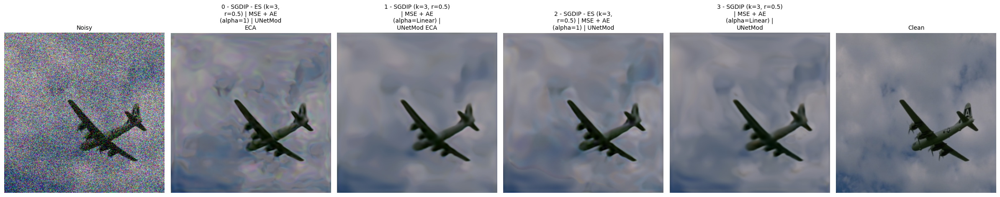

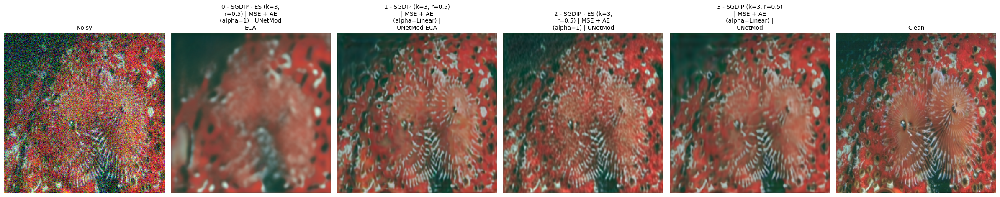

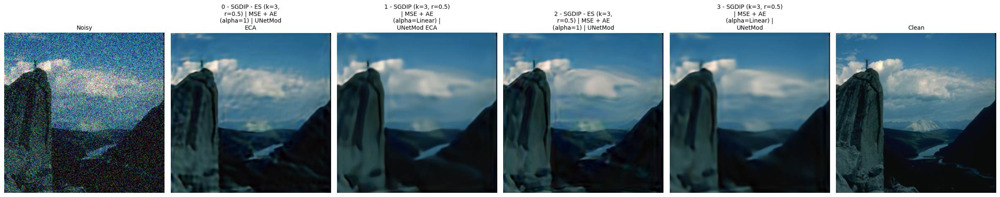

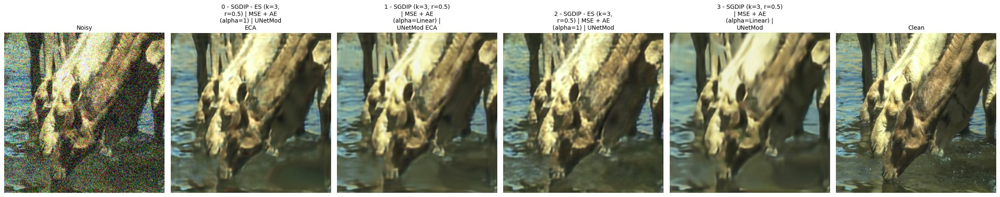

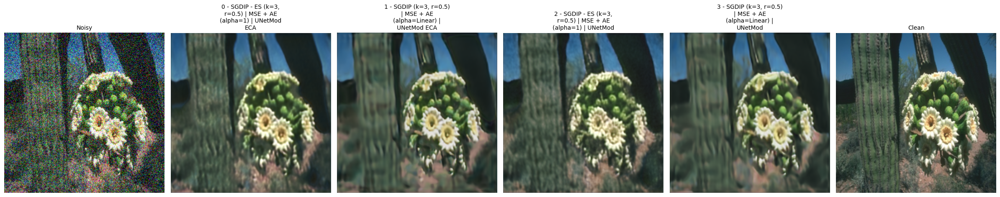

...

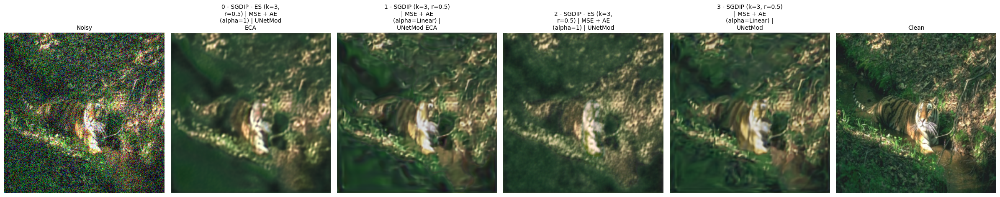

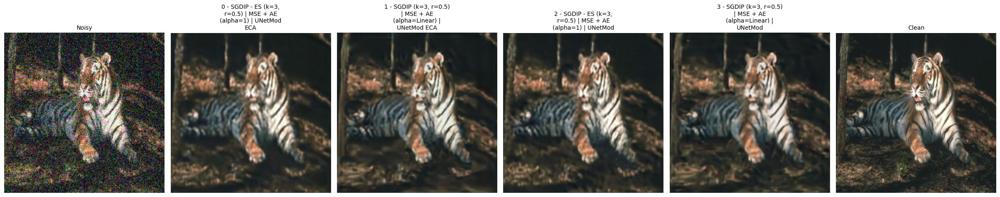

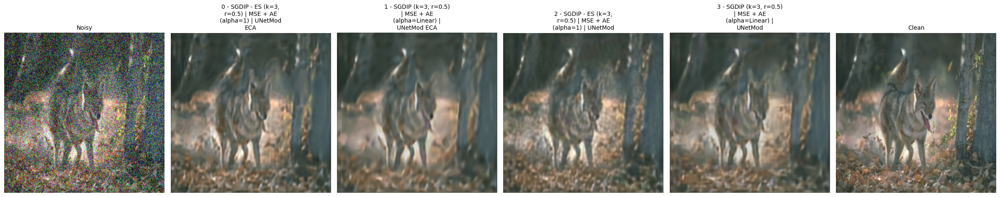

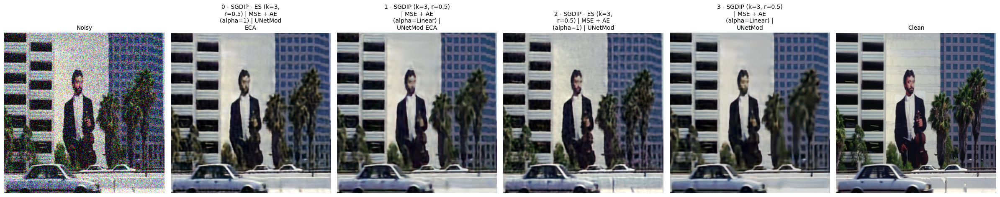

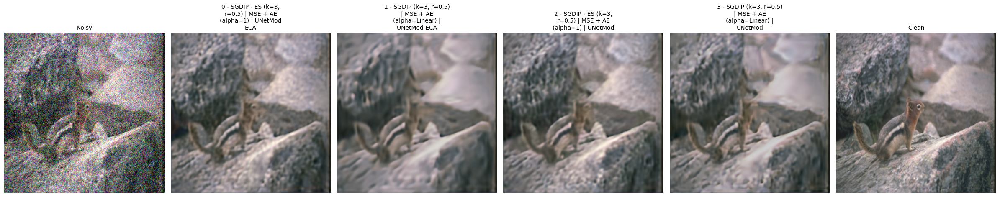

In [20]:
for result in zip(noisy, *results.values(), clean):
    utils.plot_row(result, ["Noisy", *list(results.keys()), "Clean"])

In [21]:
metrics = {
    "PSNR": PeakSignalNoiseRatio(data_range=2, reduction=None, dim=[1, 2, 3]),
    "SSIM": StructuralSimilarityIndexMeasure(data_range=2, reduction=None),
    # "LPIPS": LearnedPerceptualImagePatchSimilarity(),
}

for key, metric in metrics.items():
	print(key)
	print("----------")
	print(f"Noisy:".ljust(60), f"{metric(noisy, clean).mean()}")
	for name, xs in results.items():
		s = metric(xs, clean)
		print(f"{name}:".ljust(60), f"{s.mean()} ({s.var()})\t{s.tolist()}")
	print("\n")

PSNR
----------
Noisy:                                                       15.001901626586914
0 - SGDIP - ES (k=3, r=0.5) | MSE + AE (alpha=1) | UNetMod ECA : 26.4168701171875 (6.449012279510498)	[31.76894760131836, 21.98463249206543, 30.760032653808594, 26.331619262695312, 25.91141700744629, 26.70256233215332, 24.923816680908203, 22.597856521606445, 24.359943389892578, 27.80947494506836, 27.36703109741211, 27.474332809448242, 25.384849548339844, 30.4240779876709, 24.61016082763672, 23.486494064331055, 26.228134155273438, 27.27362060546875, 26.0952205657959, 26.84319496154785]
1 - SGDIP (k=3, r=0.5) | MSE + AE (alpha=Linear) | UNetMod ECA : 27.066802978515625 (6.304934978485107)	[34.48839569091797, 25.595497131347656, 31.117280960083008, 26.534801483154297, 26.41289520263672, 26.929546356201172, 25.824357986450195, 23.71576690673828, 24.632036209106445, 27.763185501098633, 27.677490234375, 27.807661056518555, 25.455347061157227, 30.44367027282715, 25.257020950317383, 24.2955837249755